In [2]:
#IMPORTING LIBRARIES
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

Number of images of Apple___Apple_scab: 2016 || Number of images of Apple___Black_rot: 1987 || Number of images of Apple___Cedar_apple_rust: 1760 || Number of images of Apple___healthy: 2008 || Number of images of Blueberry___healthy: 1816 || Number of images of Cherry_(including_sour)___healthy: 1826 || Number of images of Cherry_(including_sour)___Powdery_mildew: 1683 || Number of images of Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot: 1642 || Number of images of Corn_(maize)___Common_rust_: 1907 || Number of images of Corn_(maize)___healthy: 1859 || Number of images of Corn_(maize)___Northern_Leaf_Blight: 1908 || Number of images of Grape___Black_rot: 1888 || Number of images of Grape___Esca_(Black_Measles): 1920 || Number of images of Grape___healthy: 1692 || Number of images of Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 1722 || Number of images of Orange___Haunglongbing_(Citrus_greening): 2010 || Number of images of Peach___Bacterial_spot: 1838 || Number of images of Peach_

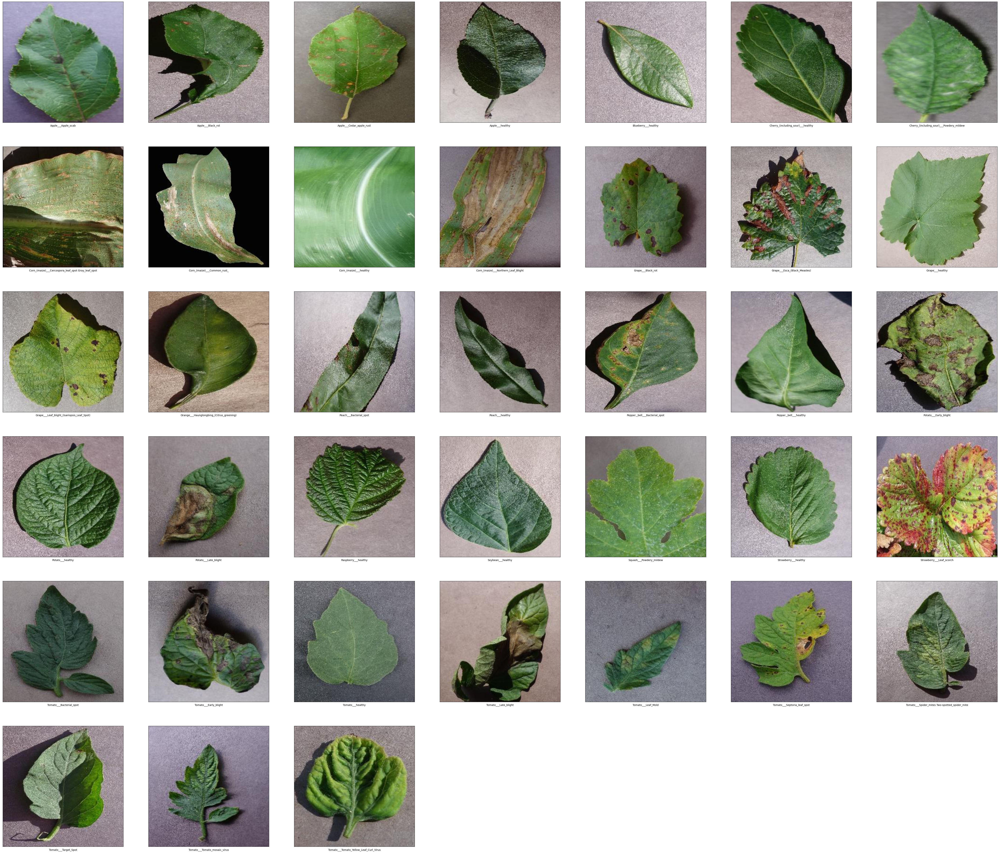

In [3]:
path='dataset/train'
plt.figure(figsize=(70,70))
count=0
plant_names=[]
total_images=0
for i in os.listdir(path):
  count+=1
  plant_names.append(i)
  plt.subplot(7,7,count)

  images_path=os.listdir(path+"/"+i)
  print("Number of images of "+i+":",len(images_path),"||",end=" ")
  total_images+=len(images_path)

  image_show=plt.imread(path+"/"+i+"/"+images_path[0])
  
  plt.imshow(image_show)
  plt.xlabel(i)
  
  plt.xticks([])
  plt.yticks([])


print("Total number of images we have",total_images)

In [4]:
print(plant_names)
print(len(plant_names))

['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___healthy', 'Potato___Late_blight', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___healthy', 'Strawberry___Leaf_scorch', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___healthy', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite',

In [5]:
import tensorflow
from tensorflow import keras
from keras.models import Sequential,load_model,Model
from keras.layers import Conv2D,MaxPool2D,AveragePooling2D,Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from keras.optimizers import SGD
from keras.initializers import glorot_uniform
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau

In [7]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input

In [8]:
base_model_tf=ResNet50(include_top=False,weights='imagenet',input_shape=(224,224,3),classes=38)


In [9]:
#Model building
base_model_tf.trainable=False

pt=Input(shape=(224,224,3))
func=tensorflow.cast(pt,tensorflow.float32)
x=preprocess_input(func) #This function used to zero-center each color channel wrt Imagenet dataset
model_resnet=base_model_tf(x,training=False)
model_resnet=GlobalAveragePooling2D()(model_resnet)
model_resnet=Dense(128,activation='relu')(model_resnet)
model_resnet=Dense(64,activation='relu')(model_resnet)
model_resnet=Dense(38,activation='softmax')(model_resnet)


model_main=Model(inputs=pt,outputs=model_resnet)
model_main.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.cast (TFOpLambda)        (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 224, 224, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)      0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                      

In [15]:
#Image augmentation
train_datagen= ImageDataGenerator(shear_range=0.2,zoom_range=0.2,horizontal_flip=False,vertical_flip=False
                                  ,fill_mode='nearest',width_shift_range=0.2,height_shift_range=0.2)

val_datagen=ImageDataGenerator()

path_train='./dataset/train'

path_valid='./dataset/valid'

train= train_datagen.flow_from_directory(directory=path_train,batch_size=32,target_size=(224,224),
                                         color_mode='rgb',class_mode='categorical',seed=42)

valid=val_datagen.flow_from_directory(directory=path_valid,batch_size=32,target_size=(224,224),color_mode='rgb',class_mode='categorical')

Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.


In [16]:
#CallBacks
es=EarlyStopping(monitor='val_accuracy',verbose=1,patience=7,mode='auto')
mc=ModelCheckpoint(filepath='./content',monitor='val_accuracy',verbose=1,save_best_only=True)
lr=ReduceLROnPlateau(monitor='val_accuracy',verbose=1,patience=5,min_lr=0.001)

In [17]:
model_main.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])


In [18]:
model_main.fit(train,validation_data=valid,epochs=30,steps_per_epoch=200,verbose=1,callbacks=[mc,es,lr])


Epoch 1/30
200/200 [==============================] - ETA: 0s - loss: 0.4861 - accuracy: 0.8569
Epoch 1: val_accuracy improved from -inf to 0.86996, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 2056s 10s/step - loss: 0.4861 - accuracy: 0.8569 - val_loss: 0.4089 - val_accuracy: 0.8700 - lr: 0.0010
Epoch 2/30
200/200 [==============================] - ETA: 0s - loss: 0.3472 - accuracy: 0.8953
Epoch 2: val_accuracy improved from 0.86996 to 0.87810, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 2018s 10s/step - loss: 0.3472 - accuracy: 0.8953 - val_loss: 0.3796 - val_accuracy: 0.8781 - lr: 0.0010
Epoch 3/30
200/200 [==============================] - ETA: 0s - loss: 0.2834 - accuracy: 0.9116
Epoch 3: val_accuracy improved from 0.87810 to 0.88846, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 3444s 17s/step - loss: 0.2834 - accuracy: 0.9116 - val_loss: 0.3555 - val_accuracy: 0.8885 - lr: 0.0010
Epoch 4/30
200/200 [==============================] - ETA: 0s - loss: 0.2457 - accuracy: 0.9234
Epoch 4: val_accuracy improved from 0.88846 to 0.93746, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 4473s 22s/step - loss: 0.2457 - accuracy: 0.9234 - val_loss: 0.1918 - val_accuracy: 0.9375 - lr: 0.0010
Epoch 5/30
200/200 [==============================] - ETA: 0s - loss: 0.2021 - accuracy: 0.9317
Epoch 5: val_accuracy did not improve from 0.93746
200/200 [==============================] - 5009s 25s/step - loss: 0.2021 - accuracy: 0.9317 - val_loss: 0.2441 - val_accuracy: 0.9164 - lr: 0.0010
Epoch 6/30
200/200 [==============================] - ETA: 0s - loss: 0.1848 - accuracy: 0.9408
Epoch 6: val_accuracy did not improve from 0.93746
200/200 [==============================] - 5813s 29s/step - loss: 0.1848 - accuracy: 0.9408 - val_loss: 0.1829 - val_accuracy: 0.9373 - lr: 0.0010
Epoch 7/30
200/200 [==============================] - ETA: 0s - loss: 0.1876 - accuracy: 0.9416
Epoch 7: val_accuracy improved from 0.93746 to 0.94235, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 4873s 24s/step - loss: 0.1876 - accuracy: 0.9416 - val_loss: 0.1713 - val_accuracy: 0.9424 - lr: 0.0010
Epoch 8/30
200/200 [==============================] - ETA: 0s - loss: 0.1876 - accuracy: 0.9389
Epoch 8: val_accuracy did not improve from 0.94235
200/200 [==============================] - 14613s 73s/step - loss: 0.1876 - accuracy: 0.9389 - val_loss: 0.2635 - val_accuracy: 0.9169 - lr: 0.0010
Epoch 9/30
200/200 [==============================] - ETA: 0s - loss: 0.1781 - accuracy: 0.9419
Epoch 9: val_accuracy did not improve from 0.94235
200/200 [==============================] - 5863s 29s/step - loss: 0.1781 - accuracy: 0.9419 - val_loss: 0.2294 - val_accuracy: 0.9247 - lr: 0.0010
Epoch 10/30
200/200 [==============================] - ETA: 0s - loss: 0.1657 - accuracy: 0.9436
Epoch 10: val_accuracy did not improve from 0.94235
200/200 [==============================] - 4112s 21s/step - loss: 0.1657 - accuracy: 0.9436 - val_loss: 0.2195 - va

INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 5755s 29s/step - loss: 0.1506 - accuracy: 0.9530 - val_loss: 0.1664 - val_accuracy: 0.9458 - lr: 0.0010
Epoch 12/30
200/200 [==============================] - ETA: 0s - loss: 0.1779 - accuracy: 0.9400 
Epoch 12: val_accuracy improved from 0.94582 to 0.94588, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 6046s 30s/step - loss: 0.1779 - accuracy: 0.9400 - val_loss: 0.1617 - val_accuracy: 0.9459 - lr: 0.0010
Epoch 13/30
200/200 [==============================] - ETA: 0s - loss: 0.1415 - accuracy: 0.9536 
Epoch 13: val_accuracy improved from 0.94588 to 0.95590, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 6423s 32s/step - loss: 0.1415 - accuracy: 0.9536 - val_loss: 0.1324 - val_accuracy: 0.9559 - lr: 0.0010
Epoch 14/30
200/200 [==============================] - ETA: 0s - loss: 0.1327 - accuracy: 0.9559
Epoch 14: val_accuracy improved from 0.95590 to 0.95863, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 5547s 28s/step - loss: 0.1327 - accuracy: 0.9559 - val_loss: 0.1234 - val_accuracy: 0.9586 - lr: 0.0010
Epoch 15/30
200/200 [==============================] - ETA: 0s - loss: 0.1314 - accuracy: 0.9573
Epoch 15: val_accuracy did not improve from 0.95863
200/200 [==============================] - 5587s 28s/step - loss: 0.1314 - accuracy: 0.9573 - val_loss: 0.1387 - val_accuracy: 0.9541 - lr: 0.0010
Epoch 16/30
200/200 [==============================] - ETA: 0s - loss: 0.1431 - accuracy: 0.9528 
Epoch 16: val_accuracy did not improve from 0.95863
200/200 [==============================] - 7032s 35s/step - loss: 0.1431 - accuracy: 0.9528 - val_loss: 0.1358 - val_accuracy: 0.9547 - lr: 0.0010
Epoch 17/30
200/200 [==============================] - ETA: 0s - loss: 0.1416 - accuracy: 0.9519
Epoch 17: val_accuracy did not improve from 0.95863
200/200 [==============================] - 5335s 27s/step - loss: 0.1416 - accuracy: 0.9519 - val_loss: 0.1504 

INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 5413s 27s/step - loss: 0.1227 - accuracy: 0.9594 - val_loss: 0.1152 - val_accuracy: 0.9606 - lr: 0.0010
Epoch 22/30
200/200 [==============================] - ETA: 0s - loss: 0.1132 - accuracy: 0.9625
Epoch 22: val_accuracy did not improve from 0.96056
200/200 [==============================] - 5908s 30s/step - loss: 0.1132 - accuracy: 0.9625 - val_loss: 0.1206 - val_accuracy: 0.9587 - lr: 0.0010
Epoch 23/30
200/200 [==============================] - ETA: 0s - loss: 0.1114 - accuracy: 0.9617
Epoch 23: val_accuracy improved from 0.96056 to 0.96751, saving model to .\content


INFO:tensorflow:Assets written to: .\content\assets


INFO:tensorflow:Assets written to: .\content\assets


200/200 [==============================] - 5885s 30s/step - loss: 0.1114 - accuracy: 0.9617 - val_loss: 0.0948 - val_accuracy: 0.9675 - lr: 0.0010
Epoch 24/30
200/200 [==============================] - ETA: 0s - loss: 0.1149 - accuracy: 0.9609
Epoch 24: val_accuracy did not improve from 0.96751
200/200 [==============================] - 8695s 44s/step - loss: 0.1149 - accuracy: 0.9609 - val_loss: 0.1233 - val_accuracy: 0.9582 - lr: 0.0010
Epoch 25/30
200/200 [==============================] - ETA: 0s - loss: 0.1137 - accuracy: 0.9618
Epoch 25: val_accuracy did not improve from 0.96751
200/200 [==============================] - 5417s 27s/step - loss: 0.1137 - accuracy: 0.9618 - val_loss: 0.1515 - val_accuracy: 0.9498 - lr: 0.0010
Epoch 26/30
200/200 [==============================] - ETA: 0s - loss: 0.1255 - accuracy: 0.9584
Epoch 26: val_accuracy did not improve from 0.96751
200/200 [==============================] - 6730s 34s/step - loss: 0.1255 - accuracy: 0.9584 - val_loss: 0.1084 -